<h1><center>Pakistan's Largest E-Commerce</center></h1>
<center>by Hari Prasetyo</center>

<h2>Latar Belakang</h2>
PAKISTAN'S LARGEST ECOMMERCE 



Sebuah perusahaan *e-commerce* di Pakistan ingin melakukan evaluasi terkait penjualannya. Perusahaan ini adalah perusahaan *e-commerce* terbesar di Pakistan. Evaluasi akan dilakukan terhadap data penjualan dari bulan Juli 2016 sampai dengan Agustus 2018.

<h2>Pernyataan Masalah</h2>
PERMASALAHAN DAN TUJUAN YANG INGIN DICAPAI

Perusahaan ingin mengetahui bagaimana penjualan dalam rentang waktu tersebut, kategori produk apa yang paling diminati, metode pembayaran apa yang paling banyak digunakan dan mengapa terdapat *cancelled* order yang cukup besar.
Lalu timbul pertanyaan, bagaimana strategi untuk meningkatkan penjualan? Lalu apa perbedaan karakteristik dari pesanan yang *completed* dengan pesanan yang *cancelled*?

*Completed* order adalah pesanan yang telah selesai.<br>
*Cancelled* order adalah pesanan yang dibatalkan atau pesanan yang pelanggannya tidak melanjutkan proses selanjutnya sehingga dibatalkan secara otomatis oleh sistem saat melewati tenggat waktu pembayarannya.

Tujuan dari analisis diatas adalah untuk dapat meningkatkan *revenue* perusahaan.

<h2>Tentang Data</h2>
1. SUMBER DATA

Dataset untuk keperluan analisis tersebut dapat diperoleh [**di sini**](https://www.kaggle.com/datasets/zusmani/pakistans-largest-ecommerce-dataset).

In [193]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels as sm
import plotly.express as px

<h2>Tentang Data</h2>
2. MEMAHAMI DATA

Dataset ini berisi informasi terkait penjualan, kategori produk, status pesanan dan metode pembayaran dari bulan Juli 2016 sampai dengan Agustus 2018. Terdapat 21 kolom di dalam dataset tersebut, yaitu:  

1. **item_id**: ID dari produk yang dijual             
1. **status**: Status order sampai dengan saat ini
1. **created_at**: Tanggal dibuatnya order
1. **sku**: Stock Keeping Unit / kode unik suatu barang
1. **price**: Harga produk
1. **qty_ordered**: Jumlah produk yang diorder
1. **grand_total**: Total yang harus dibayarkan dari satu nomor ID pemesanan
1. **increment_id**: Nomor ID pemesanan
1. **category_name_1**: Kategori produk
1. **sales_commission_code**: Kode komisi yang digunakan saat order
1. **discount_amount**: Jumlah diskon dalam satu nomor ID pemesanan
1. **payment_method**: Metode pembayaran yang digunakan
1. **Working Date**: Tanggal bekerja
1. **BI Status**: Kelompok status default
1. **MV**: Total yang harus dibayarkan
1. **Year**: Tahun dibuatnya pemesanan
1. **Month**: Bulan dibuatnya pemesanan
1. **Customer Since**: Tanggal pembuatan akun pelanggan
1. **M-Y**: Bulan dan Tanggal pemesanan
1. **FY**: Tahun Fiskal
1. **Customer ID**: Nomor ID pelanggan

Berikut 5 baris teratas dan terbawahnya

In [194]:
df = pd.read_csv('Pakistan Largest Ecommerce Dataset.csv')
display(df.head(5),df.tail(5))

/var/folders/2x/skq8kcjs21j13cfhv6mbf_600000gn/T/ipykernel_98632/76581358.py:1: DtypeWarning:

Columns (1,2,3,7,8,9,11,12,13,14,17,18,19) have mixed types. Specify dtype option on import or set low_memory=False.



,item_id,status,created_at,sku,price,qty_ordered,grand_total,increment_id,category_name_1,sales_commission_code,...,Month,Customer Since,M-Y,FY,Customer ID,Unnamed: 21,Unnamed: 22,Unnamed: 23,Unnamed: 24,Unnamed: 25
0,211131.0,complete,7/1/2016,kreations_YI 06-L,1950.0,1.0,1950.0,100147443,Women's Fashion,\N,...,7.0,2016-7,7-2016,FY17,1.0,NaN,NaN,NaN,NaN,NaN
1,211133.0,canceled,7/1/2016,kcc_Buy 2 Frey Air Freshener & Get 1 Kasual Bo...,240.0,1.0,240.0,100147444,Beauty & Grooming,\N,...,7.0,2016-7,7-2016,FY17,2.0,NaN,NaN,NaN,NaN,NaN
2,211134.0,canceled,7/1/2016,Ego_UP0017-999-MR0,2450.0,1.0,2450.0,100147445,Women's Fashion,\N,...,7.0,2016-7,7-2016,FY17,3.0,NaN,NaN,NaN,NaN,NaN
3,211135.0,complete,7/1/2016,kcc_krone deal,360.0,1.0,60.0,100147446,Beauty & Grooming,R-FSD-52352,...,7.0,2016-7,7-2016,FY17,4.0,NaN,NaN,NaN,NaN,NaN
4,211136.0,order_refunded,7/1/2016,BK7010400AG,555.0,2.0,1110.0,100147447,Soghaat,\N,...,7.0,2016-7,7-2016,FY17,5.0,NaN,NaN,NaN,NaN,NaN


,item_id,status,created_at,sku,price,qty_ordered,grand_total,increment_id,category_name_1,sales_commission_code,...,Month,Customer Since,M-Y,FY,Customer ID,Unnamed: 21,Unnamed: 22,Unnamed: 23,Unnamed: 24,Unnamed: 25
1048570,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1048571,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1048572,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1048573,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1048574,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Pertama, mari kita lihat informasi dan deskriptif dari dataset.

In [195]:
display(df.describe(), df.describe(include='object') )

,item_id,price,qty_ordered,grand_total,discount_amount,Year,Month,Customer ID,Unnamed: 21,Unnamed: 22,Unnamed: 23,Unnamed: 24,Unnamed: 25
count,584524.000000,5.845240e+05,584524.000000,5.845240e+05,584524.000000,584524.000000,584524.000000,584513.000000,0.0,0.0,0.0,0.0,0.0
mean,565667.074218,6.348748e+03,1.296388,8.530619e+03,499.492775,2017.044115,7.167654,45790.511965,NaN,NaN,NaN,NaN,NaN
std,200121.173648,1.494927e+04,3.996061,6.132081e+04,1506.943046,0.707355,3.486305,34414.962389,NaN,NaN,NaN,NaN,NaN
min,211131.000000,0.000000e+00,1.000000,-1.594000e+03,-599.500000,2016.000000,1.000000,1.000000,NaN,NaN,NaN,NaN,NaN
25%,395000.750000,3.600000e+02,1.000000,9.450000e+02,0.000000,2017.000000,4.000000,13516.000000,NaN,NaN,NaN,NaN,NaN
50%,568424.500000,8.990000e+02,1.000000,1.960400e+03,0.000000,2017.000000,7.000000,42856.000000,NaN,NaN,NaN,NaN,NaN
75%,739106.250000,4.070000e+03,1.000000,6.999000e+03,160.500000,2018.000000,11.000000,73536.000000,NaN,NaN,NaN,NaN,NaN
max,905208.000000,1.012626e+06,1000.000000,1.788800e+07,90300.000000,2018.000000,12.000000,115326.000000,NaN,NaN,NaN,NaN,NaN


,status,created_at,sku,increment_id,category_name_1,sales_commission_code,payment_method,Working Date,BI Status,MV,Customer Since,M-Y,FY
count,584509,584524,584504,584524,584360,447349,584524,584524,584524,584524,584513,584524,584524
unique,16,789,84889,408785,16,7226,18,789,4,9720,26,26,3
top,complete,11/25/2016,MATSAM59DB75ADB2F80,100266667,Mobiles & Tablets,\N,cod,11/25/2016,Net,999,2016-11,11-2017,FY18
freq,233685,15169,3775,72,115710,339001,271960,15169,234178,9516,82714,83928,306883


In [196]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1048575 entries, 0 to 1048574
Data columns (total 26 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   item_id                584524 non-null  float64
 1   status                 584509 non-null  object 
 2   created_at             584524 non-null  object 
 3   sku                    584504 non-null  object 
 4   price                  584524 non-null  float64
 5   qty_ordered            584524 non-null  float64
 6   grand_total            584524 non-null  float64
 7   increment_id           584524 non-null  object 
 8   category_name_1        584360 non-null  object 
 9   sales_commission_code  447349 non-null  object 
 10  discount_amount        584524 non-null  float64
 11  payment_method         584524 non-null  object 
 12  Working Date           584524 non-null  object 
 13  BI Status              584524 non-null  object 
 14   MV                    584524 non-

In [197]:
df.isna().sum()

item_id                   464051
status                    464066
created_at                464051
sku                       464071
price                     464051
qty_ordered               464051
grand_total               464051
increment_id              464051
category_name_1           464215
sales_commission_code     601226
discount_amount           464051
payment_method            464051
Working Date              464051
BI Status                 464051
 MV                       464051
Year                      464051
Month                     464051
Customer Since            464062
M-Y                       464051
FY                        464051
Customer ID               464062
Unnamed: 21              1048575
Unnamed: 22              1048575
Unnamed: 23              1048575
Unnamed: 24              1048575
Unnamed: 25              1048575
dtype: int64

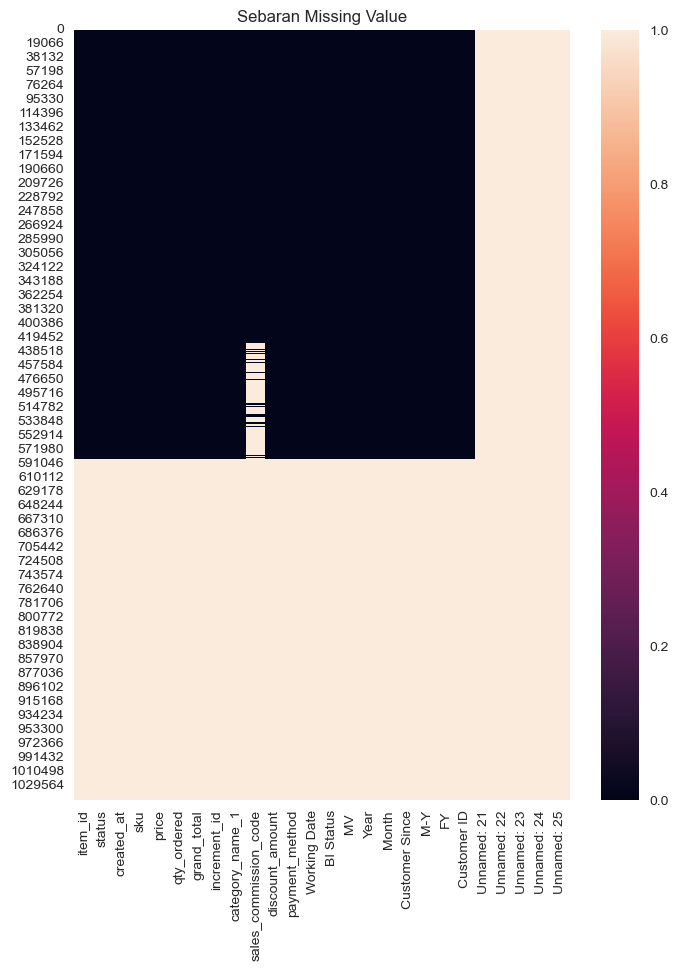

In [198]:
# Sebaran missing value di dalam data
plt.figure(figsize=(8,10))
sns.heatmap(df.isna())
plt.title('Sebaran Missing Value')
plt.show()

<AxesSubplot:xlabel='price'>

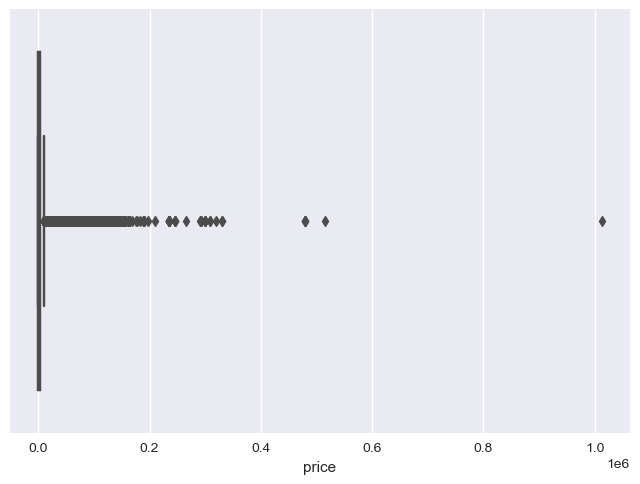

In [199]:
#Melihat outlier dari kolom Price
sns.boxplot(x=df['price'])

<AxesSubplot:xlabel='grand_total'>

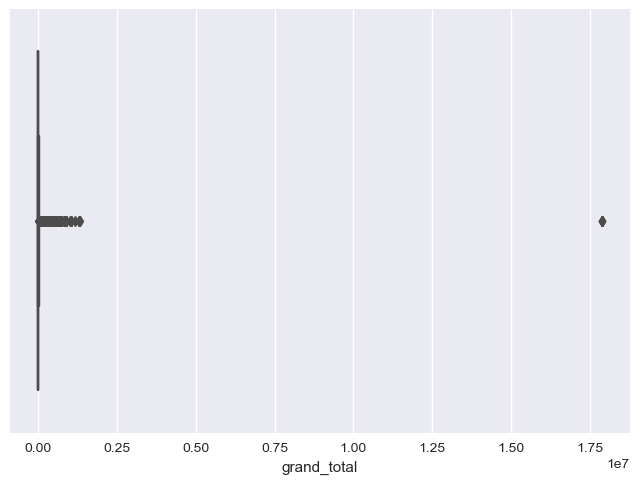

In [200]:
#Melihat outlier dari kolom grand_total
sns.boxplot(x=df['grand_total'])

In [201]:
#mencari duplikat
print('Jumlah duplikat:', df.duplicated().sum())

Jumlah duplikat: 464050


Tentang data secara garis besar:
1. Pakistan Largest Ecommerce Dataset memiliki **1,048,575 baris dan 26 kolom**.
2. Kolom `created_at` dan `M-Y` memiliki data type object, seharusnya memiliki tipe data datetime.
1. Nilai Minimum pada kolom `grand_total` dan `discount_amount` negatif (kurang dari 0). Seharusnya tidak kurang dari 0.
2. Terdapat banyak *Missing Value* dimana ada kolom dan baris yang 100% kosong.
1. Kolom `sales_commision_code` memiliki Missing value yang cukup banyak, namun karena kita tidak akan menggunakannya, kolom tersebut akan dihapus.
1. Terlalu banyak outlier pada kolom `price` dan `grand_total`, namun tidak akan kita hapus karena outlier tersebut adalah fakta data dari harga barang yang ada di e-commerce.
1. Jumlah duplikat terlalu banyak, sepertinya itu adalah baris kosong, mari kita cek kembali setelah drop baris kosong.

***
<h2>Data Cleaning</h2> 
1. DROPPING UNNECESSARY COLUMNS AND ROWS

Kolom dan baris yang akan dihapus diantaranya adalah:
1. **Kolom kosong** \
    Kolom *`Unnamed: 21, Unnamed: 22, Unnamed: 23, Unnamed: 24 dan Unnamed: 25`* memiliki 100% missing value. Data pada kolom tersebut memang kosong.
    
1. **Kolom yang kurang relevan** 
    - Kolom *`sales_commission_code`* berisikan kode *refferal* komisi penjualan yang tidak relevan dalam analisis. Kolom tersebut juga memiliki banyak missing value.
    - Kolom `Working_Date` memiliki informasi yang sama dengan 'created_at'.
    - Kolom ` MV ` memiliki informasi yang sama dengan 'grand_total'.
    - Kolom `BI_status` kurang relevan karena cenerung sulit dalam analisis. Kita akan membuat pengelompokan baru agar lebih mudah dipahami.
<br>
<br>
1. **Baris kosong** \
    Menghapus baris yang memiliki 100% data kosong di baris tersebut.

In [202]:
# Menghapus Kolom Kosong
df.drop(df[['Unnamed: 21', 'Unnamed: 22', 'Unnamed: 23','Unnamed: 24', 'Unnamed: 25']],axis=1,inplace=True)

# Menghapus Kolom yang Kurang Relevan
df.drop(['sales_commission_code',' MV ','Working Date', 'BI Status'], axis = 1, inplace=True)

# Menghapus Baris Kosong
df.dropna(how='all', axis=0, inplace=True)
df


,item_id,status,created_at,sku,price,qty_ordered,grand_total,increment_id,category_name_1,discount_amount,payment_method,Year,Month,Customer Since,M-Y,FY,Customer ID
0,211131.0,complete,7/1/2016,kreations_YI 06-L,1950.0,1.0,1950.0,100147443,Women's Fashion,0.0,cod,2016.0,7.0,2016-7,7-2016,FY17,1.0
1,211133.0,canceled,7/1/2016,kcc_Buy 2 Frey Air Freshener & Get 1 Kasual Bo...,240.0,1.0,240.0,100147444,Beauty & Grooming,0.0,cod,2016.0,7.0,2016-7,7-2016,FY17,2.0
2,211134.0,canceled,7/1/2016,Ego_UP0017-999-MR0,2450.0,1.0,2450.0,100147445,Women's Fashion,0.0,cod,2016.0,7.0,2016-7,7-2016,FY17,3.0
3,211135.0,complete,7/1/2016,kcc_krone deal,360.0,1.0,60.0,100147446,Beauty & Grooming,300.0,cod,2016.0,7.0,2016-7,7-2016,FY17,4.0
4,211136.0,order_refunded,7/1/2016,BK7010400AG,555.0,2.0,1110.0,100147447,Soghaat,0.0,cod,2016.0,7.0,2016-7,7-2016,FY17,5.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
584519,905204.0,cod,8/28/2018,WOFSCE5AE00357AECDE,699.0,1.0,849.0,100562385,Women's Fashion,0.0,cod,2018.0,8.0,2018-8,8-2018,FY19,115320.0
584520,905205.0,processing,8/28/2018,MATHUA5AF70A7D1E50A,35599.0,1.0,35899.0,100562386,Mobiles & Tablets,0.0,bankalfalah,2018.0,8.0,2018-8,8-2018,FY19,115326.0
584521,905206.0,processing,8/28/2018,MATSAM5B6D7208C6D30,129999.0,2.0,652178.0,100562387,Mobiles & Tablets,0.0,bankalfalah,2018.0,8.0,2018-7,8-2018,FY19,113474.0
584522,905207.0,processing,8/28/2018,MATSAM5B1509B4696EA,87300.0,2.0,652178.0,100562387,Mobiles & Tablets,0.0,bankalfalah,2018.0,8.0,2018-7,8-2018,FY19,113474.0


In [203]:
# Persentase missing value pada setiap kolom
df.isna().sum()/df.shape[0]*100

item_id            0.000000
status             0.002566
created_at         0.000000
sku                0.003422
price              0.000000
qty_ordered        0.000000
grand_total        0.000000
increment_id       0.000000
category_name_1    0.028057
discount_amount    0.000000
payment_method     0.000000
Year               0.000000
Month              0.000000
Customer Since     0.001882
M-Y                0.000000
FY                 0.000000
Customer ID        0.001882
dtype: float64

Dapat dilihat persentase missing value pada masing-masing kolom sekarang menjadi sangat kecil, mari kita drop saja.

In [204]:
df.dropna(inplace=True)
df

,item_id,status,created_at,sku,price,qty_ordered,grand_total,increment_id,category_name_1,discount_amount,payment_method,Year,Month,Customer Since,M-Y,FY,Customer ID
0,211131.0,complete,7/1/2016,kreations_YI 06-L,1950.0,1.0,1950.0,100147443,Women's Fashion,0.0,cod,2016.0,7.0,2016-7,7-2016,FY17,1.0
1,211133.0,canceled,7/1/2016,kcc_Buy 2 Frey Air Freshener & Get 1 Kasual Bo...,240.0,1.0,240.0,100147444,Beauty & Grooming,0.0,cod,2016.0,7.0,2016-7,7-2016,FY17,2.0
2,211134.0,canceled,7/1/2016,Ego_UP0017-999-MR0,2450.0,1.0,2450.0,100147445,Women's Fashion,0.0,cod,2016.0,7.0,2016-7,7-2016,FY17,3.0
3,211135.0,complete,7/1/2016,kcc_krone deal,360.0,1.0,60.0,100147446,Beauty & Grooming,300.0,cod,2016.0,7.0,2016-7,7-2016,FY17,4.0
4,211136.0,order_refunded,7/1/2016,BK7010400AG,555.0,2.0,1110.0,100147447,Soghaat,0.0,cod,2016.0,7.0,2016-7,7-2016,FY17,5.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
584519,905204.0,cod,8/28/2018,WOFSCE5AE00357AECDE,699.0,1.0,849.0,100562385,Women's Fashion,0.0,cod,2018.0,8.0,2018-8,8-2018,FY19,115320.0
584520,905205.0,processing,8/28/2018,MATHUA5AF70A7D1E50A,35599.0,1.0,35899.0,100562386,Mobiles & Tablets,0.0,bankalfalah,2018.0,8.0,2018-8,8-2018,FY19,115326.0
584521,905206.0,processing,8/28/2018,MATSAM5B6D7208C6D30,129999.0,2.0,652178.0,100562387,Mobiles & Tablets,0.0,bankalfalah,2018.0,8.0,2018-7,8-2018,FY19,113474.0
584522,905207.0,processing,8/28/2018,MATSAM5B1509B4696EA,87300.0,2.0,652178.0,100562387,Mobiles & Tablets,0.0,bankalfalah,2018.0,8.0,2018-7,8-2018,FY19,113474.0


In [205]:
#mencari duplikat
print('Setelah drop baris kosong, jumlah duplikat menjadi:', df.duplicated().sum())

Setelah drop baris kosong, jumlah duplikat menjadi: 0


<h2>Data Cleaning</h2> 
2. FIXING DATA TYPE

Mengubah tipe data di kolom `created_at` dan `M-Y` dari tipe data *object* menjadi *datetime*.

In [206]:
df['created_at'] = pd.to_datetime(df['created_at'])
df['M-Y'] = pd.to_datetime(df['M-Y'])

<h2>Data Cleaning</h2> 
3. FIXING NEGATIVE VALUE



1. **Kolom `grand_total`** \
    Kolom 'grand_total' memiliki 76 baris yang nilainya kurang dari nol, dimana seharusnya tidak demikian. Kemungkinan data tersebut adalah pembelian dengan metode cicilan sehingga di awal pemesanan tidak langsung membayar. Kita akan rubah angka negatifnya menjadi nol (0).

1. **Kolom `discount_amount`** \
    Kolom 'discount_amount' memiliki 3 baris yang nilainya kurang dari nol. Kemungkinan terjadi kesalahan penginputan data. Kita akan rubah angkanya menjadi positif.

In [207]:
# Berikut adalah data yang memiliki nilai grand_total < 0
df[df['grand_total']<0]

,item_id,status,created_at,sku,price,qty_ordered,grand_total,increment_id,category_name_1,discount_amount,payment_method,Year,Month,Customer Since,M-Y,FY,Customer ID
209940,473144.0,complete,2017-05-19,lalassc_SSP-07A,1200.0,1.0,-10.0,100306233,Women's Fashion,300.0000,Payaxis,2017.0,5.0,2016-11,2017-05-01,FY17,15714.0
242331,510950.0,received,2017-06-12,SN_Muzadati-500gm,170.0,1.0,-6.4,100324785,Soghaat,74.8095,Easypay,2017.0,6.0,2016-7,2017-06-01,FY17,967.0
242332,510951.0,received,2017-06-12,Nimcos_Namak-Paray-200gm,98.0,2.0,-6.4,100324785,Soghaat,86.2510,Easypay,2017.0,6.0,2016-7,2017-06-01,FY17,967.0
242333,510952.0,received,2017-06-12,Nimcos_Crunchy-Mix-400gm,216.0,1.0,-6.4,100324785,Soghaat,95.0521,Easypay,2017.0,6.0,2016-7,2017-06-01,FY17,967.0
242334,510953.0,received,2017-06-12,RS_Sohan Halwa 1000gm,660.0,1.0,-6.4,100324785,Soghaat,290.4370,Easypay,2017.0,6.0,2016-7,2017-06-01,FY17,967.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
571270,890219.0,complete,2018-07-27,MEFOXF5B39EF5CC541E-M,420.0,1.0,-340.6,100553654,Men's Fashion,612.6000,bankalfalah,2018.0,7.0,2016-8,2018-07-01,FY19,3732.0
571271,890221.0,complete,2018-07-27,VIT5AC4A6E65D6C6,180.0,1.0,-340.6,100553654,Superstore,612.6000,bankalfalah,2018.0,7.0,2016-8,2018-07-01,FY19,3732.0
571272,890222.0,complete,2018-07-27,HIJ5B2204D154E0F,450.0,1.0,-340.6,100553654,Superstore,612.6000,bankalfalah,2018.0,7.0,2016-8,2018-07-01,FY19,3732.0
571273,890223.0,complete,2018-07-27,HASQAR5A53699375950,98.0,4.0,-340.6,100553654,Health & Sports,612.6000,bankalfalah,2018.0,7.0,2016-8,2018-07-01,FY19,3732.0


In [208]:
# Mengubah data negative pada kolom grand total menjadi 0
df.loc[(df['grand_total']< 0), 'grand_total']=0

In [209]:
# Berikut adalah data yang memiliki nilai discount_amount < 0
df[df['discount_amount']<0]

,item_id,status,created_at,sku,price,qty_ordered,grand_total,increment_id,category_name_1,discount_amount,payment_method,Year,Month,Customer Since,M-Y,FY,Customer ID
152474,403716.0,canceled,2017-02-13,akl-GFSU1265-M,5995.0,1.0,5395.5,100269243,Women's Fashion,-599.5,Payaxis,2017.0,2.0,2016-7,2017-02-01,FY17,73.0
152478,403730.0,order_refunded,2017-02-13,test-product,4.0,2.0,156.0,100269252,\N,-2.0,Payaxis,2017.0,2.0,2016-7,2017-02-01,FY17,1423.0
152479,403731.0,canceled,2017-02-13,RB_HouseholdBundle,1000.0,5.0,4998.0,100269253,Superstore,-2.0,Payaxis,2017.0,2.0,2016-7,2017-02-01,FY17,73.0


In [210]:
# Mengubah data negative pada kolom grand total menjadi positf
df.loc[(df['discount_amount']< 0), 'discount_amount'] = df.loc[(df['discount_amount']< 0), 'discount_amount'].abs()

***
<h2>Data After Cleaning</h2> 

Berikut adalah info data setelah dilakukan *Data Cleaning*: 
- Jumlah baris menjadi 584314, dan jumlah kolom adalah 17.
- Sudah tidak ada missing value dalam data.
- Sudah tidak ada nilai negative dalam data.
- Sudah tidak ada duplikat dalam data.
- Tipe data `create_at` dan `M-Y` sudah menjadi datetime.

In [211]:
listItem = []
for kolom in df.columns :
    listItem.append([kolom, 
                     df[kolom].dtype,
                     df[kolom].isna().sum(),
                     df[kolom].nunique()]);

dfDesc = pd.DataFrame(columns=[ 'Nama_Kolom',
                                'Tipe_Data',
                                'Null', 
                                'Unique'],
                     data=listItem)

print('Jumlah Baris: ',df.shape[0],'\n' 'Jumlah Kolom: ',df.shape[1])

dfDesc

Jumlah Baris:  584314 
Jumlah Kolom:  17


,Nama_Kolom,Tipe_Data,Null,Unique
0,item_id,float64,0,584314
1,status,object,0,16
2,created_at,datetime64[ns],0,789
3,sku,object,0,84869
4,price,float64,0,9119
5,qty_ordered,float64,0,73
6,grand_total,float64,0,36800
7,increment_id,object,0,408659
8,category_name_1,object,0,16
9,discount_amount,float64,0,28056


In [212]:
display(df.describe(include='object'))
df.describe()

,status,sku,increment_id,category_name_1,payment_method,Customer Since,FY
count,584314,584314,584314,584314,584314,584314,584314
unique,16,84869,408659,16,18,26,3
top,complete,MATSAM59DB75ADB2F80,100266667,Mobiles & Tablets,cod,2016-11,FY18
freq,233684,3775,72,115709,271770,82710,306695


,item_id,price,qty_ordered,grand_total,discount_amount,Year,Month,Customer ID
count,584314.000000,5.843140e+05,584314.000000,5.843140e+05,584314.000000,584314.000000,584314.000000,584314.000000
mean,565590.346478,6.350766e+03,1.294308,8.532931e+03,499.657393,2017.043819,7.168726,45779.112402
std,200101.173141,1.495150e+04,3.988150,6.133168e+04,1507.185123,0.707261,3.486263,34411.486271
min,211131.000000,0.000000e+00,1.000000,0.000000e+00,0.000000,2016.000000,1.000000,1.000000
25%,394945.250000,3.600000e+02,1.000000,9.452000e+02,0.000000,2017.000000,4.000000,13511.000000
50%,568301.000000,8.994000e+02,1.000000,1.961000e+03,0.000000,2017.000000,7.000000,42850.000000
75%,738981.750000,4.090000e+03,1.000000,6.999000e+03,160.734400,2018.000000,11.000000,73513.750000
max,905208.000000,1.012626e+06,1000.000000,1.788800e+07,90300.000000,2018.000000,12.000000,115326.000000


***
<h2>Data Analisis</h2>
1. MENAMBAH KOLOM GROSS TOTAL

Kita tidak bisa secara langsung melakukan penjumlahan pada kolom `grand_total` dan `discount_amount` karena kolom tersebut merupakan **duplikat** dari masing-masing `increment_id` (nomor pemesanan) nya.

Misal pada nomor pemesanan **100535753** terdapat 41 item yang dipesan. Jika kita coba mengalikan `price` dengan `qty_ordered` dan dikurangi `discount_amount`, hasilnya tidak sama dengan nilai `grand_total`.

Mari kita buat kolom baru bernama `gross_total` yang nilainya adalah `price` * `qty_ordered`.

In [213]:
#Membuat kolom baru bernama gross_total
df['gross_total'] = df['price']*df['qty_ordered']

Kemudian mari kita coba buktikan apakah benar kolom `grand_total` dan `discount_amount` adalah duplikat.

In [214]:
df['increment_id'].value_counts().head()

100266667    72
100286851    47
100346364    45
100476608    43
100535753    41
Name: increment_id, dtype: int64

Kita coba periksa pada increment id **100535753** yang memiliki 41 baris.

In [215]:
display(df[['status','created_at','Customer ID','price','qty_ordered','discount_amount','grand_total','gross_total']][df['increment_id']=='100535753'].head())

sumGross = df['gross_total'][df['increment_id']=='100535753'].sum()
disc = df['discount_amount'][df['increment_id']=='100535753'].mean()

print(sumGross)
print(disc)
print(sumGross-disc)

print('Hasil dari penjumlahan gross_total dikurangi discount, bernilai sama dengan grand_total yaitu: ',sumGross-disc,'\nMaka benar grand_total dan discount_amount adalah duplikat untuk masing-masing increment_id-nya')

,status,created_at,Customer ID,price,qty_ordered,discount_amount,grand_total,gross_total
544136,canceled,2018-05-27,108638.0,629.0,2.0,5423.25,30731.75,1258.0
544137,canceled,2018-05-27,108638.0,699.0,1.0,5423.25,30731.75,699.0
544138,canceled,2018-05-27,108638.0,629.0,1.0,5423.25,30731.75,629.0
544139,canceled,2018-05-27,108638.0,629.0,1.0,5423.25,30731.75,629.0
544140,canceled,2018-05-27,108638.0,699.0,1.0,5423.25,30731.75,699.0


36155.0
5423.25
30731.75
Hasil dari penjumlahan gross_total dikurangi discount, bernilai sama dengan grand_total yaitu:  30731.75 
Maka benar grand_total dan discount_amount adalah duplikat untuk masing-masing increment_id-nya


Oleh karena itu, jika ingin mencari total penjualan, tidak bisa langsung menjumlah kolom tersebut.

<h2>Data Analisis</h2>
2. MENGELOMPOKKAN STATUS PESANAN

Untuk memudahkan analisis, kita akan membuat pengelompokan baru terhadap status pemesanan.

* **Completed**: berisi status yang *complete*
* **Cancelled**: berisi status yang *canceled*
* **Refunded**: berisi status yang *order_refunded*
* **Processing**: seluruh status selain ketiga diatas kita anggap masih dalam proses dan belum selesai.

Mari kita memasukkan pengelompokan baru tersebut pada kolom baru bernama `status_distinct`

In [216]:
df['status_distinct']=df['status']
statusDistinct = {  'Completed':['complete'],
                    'Cancelled':['canceled'],
                    'Refunded':['order_refunded'], 
                    'Processing':['\\N','closed','received','cod','paid','exchange','payment_review','pending','processing','holded','pending_paypal','refund','fraud']}
for n in range(len(statusDistinct)):
    key,value=list(statusDistinct.items())[n]
    df['status_distinct'].replace(value, key,inplace=True)
    n+=1

In [217]:
df['status_distinct'].value_counts()

Completed     233684
Cancelled     201127
Processing     90005
Refunded       59498
Name: status_distinct, dtype: int64

In [218]:
#Export data yang sudah di cleaning menjadi file csv untuk visualisasi di Tableau.
df.to_csv('Pakistan Data Cleaned Analyze.csv', index=False)

<h2>Data Analisis</h2>
3. SALES OVERVIEW

Pertama, mari kita membuat tabel yang dikelompokkan dengan status *Completed* untuk melihat garis besar penjualan.\
Kemudian kita akan analisis:
1. Berapa jumlah order dan jumlah unique User?
1. Berapa jumlah **Completed Order** tiap bulan?
1. Lalu berapa **Total Gross Penjualan** dari completed order tersebut?
1. **Category** apa yang paling banyak diminati dari **seluruh transaksi**?
1. **Category** apa yang paling banyak diminati pada ***Completed*** orders?
1. **Metode pembayaran** apa yang paling banyak digunakan dari **seluruh transaksi**?
1. **Metode pembayaran** apa yang paling banyak digunakan pada ***Completed*** orders?
1. Berapa total **jumlah order** berdasarkan pengelompokan **Status**?
8. Berapa potensi yang hilang dari **cancelled order**?

In [219]:
#Membuat tabel dengan pengelompokan status Completed
dfCompleted = df[df['status_distinct']=='Completed']
dfCompleted.head()

,item_id,status,created_at,sku,price,qty_ordered,grand_total,increment_id,category_name_1,discount_amount,payment_method,Year,Month,Customer Since,M-Y,FY,Customer ID,gross_total,status_distinct
0,211131.0,complete,2016-07-01,kreations_YI 06-L,1950.0,1.0,1950.0,100147443,Women's Fashion,0.0,cod,2016.0,7.0,2016-7,2016-07-01,FY17,1.0,1950.0,Completed
3,211135.0,complete,2016-07-01,kcc_krone deal,360.0,1.0,60.0,100147446,Beauty & Grooming,300.0,cod,2016.0,7.0,2016-7,2016-07-01,FY17,4.0,360.0,Completed
6,211138.0,complete,2016-07-01,kcc_krone deal,360.0,1.0,60.0,100147449,Beauty & Grooming,300.0,cod,2016.0,7.0,2016-7,2016-07-01,FY17,7.0,360.0,Completed
7,211139.0,complete,2016-07-01,UK_Namkino Mix Nimco 400 Gms,170.0,1.0,170.0,100147450,Soghaat,0.0,cod,2016.0,7.0,2016-7,2016-07-01,FY17,6.0,170.0,Completed
10,211142.0,complete,2016-07-01,"GFC_Pedestal Myga Cross Base (Special Guard) 24""",5500.0,1.0,5500.0,100147453,Appliances,0.0,cod,2016.0,7.0,2016-7,2016-07-01,FY17,9.0,5500.0,Completed


<h4>1. Berapa Jumlah Order dan Jumlah Unique User Sampai Dengan Saat Ini?</h4>
(Data Analisis - Sales Overview)


In [220]:
print('Jumlah Order dari seluruh transaksi ada sebanyak',df['gross_total'].count())
print('Jumlah Unique users dari seluruh transaksi ada sebanyak',df['Customer ID'].nunique())

Jumlah Order dari seluruh transaksi ada sebanyak 584314
Jumlah Unique users dari seluruh transaksi ada sebanyak 115304


<h4>2. Berapa Jumlah Completed Order Tiap Bulan?</h4>
(Data Analisis - Sales Overview)


Total Order = 584314
Total Completed Order = 233684


,M-Y,count,cumulative_count
0,2016-07-01,5877,5877
1,2016-08-01,7497,13374
2,2016-09-01,8117,21491
3,2016-10-01,7561,29052
4,2016-11-01,37492,66544
5,2016-12-01,8066,74610
6,2017-01-01,7600,82210
7,2017-02-01,6935,89145
8,2017-03-01,11406,100551
9,2017-04-01,10930,111481


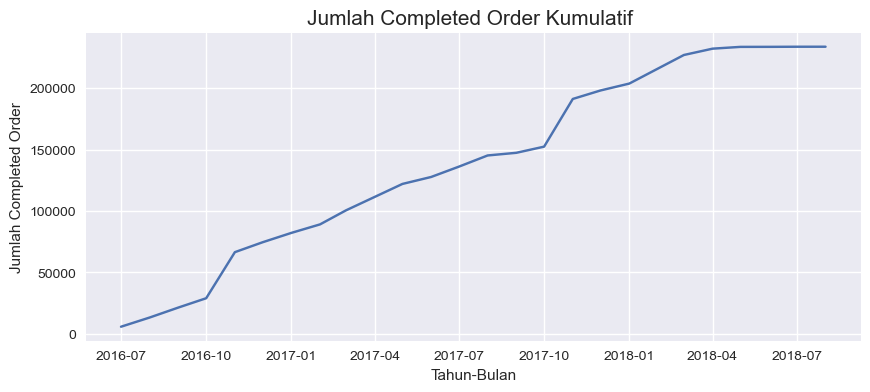

In [221]:
# Membuat tabel jumlah completed order perbulan
lineCompletedCount=dfCompleted.groupby('M-Y')['gross_total'].agg(['count']).reset_index()
lineCompletedCount["cumulative_count"] = lineCompletedCount['count'].cumsum()

print('Total Order =', df['gross_total'].count())
print('Total Completed Order =', lineCompletedCount['count'].sum())
display(lineCompletedCount)

# Membuat visualisasi jumlah order kumulatif
plt.style.use('seaborn')
plt.figure(figsize = (10,4))
sns.lineplot(   data=lineCompletedCount, 
                x=lineCompletedCount['M-Y'], 
                y=lineCompletedCount['cumulative_count'])
plt.title('Jumlah Completed Order Kumulatif ', size = 15)
plt.xlabel('Tahun-Bulan')
plt.ylabel('Jumlah Completed Order')
plt.show()

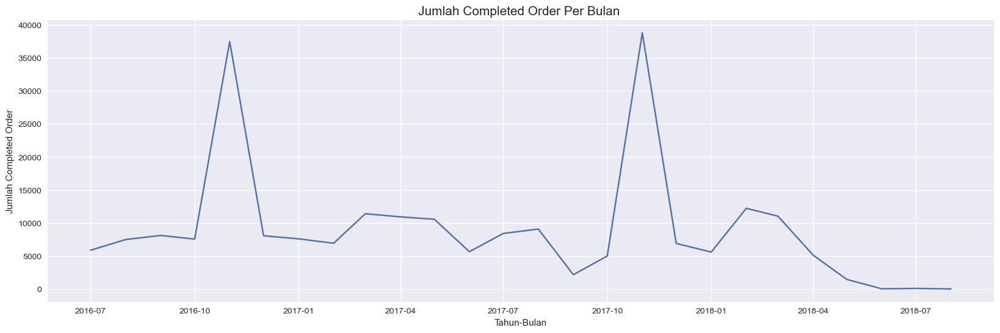

In [222]:
# Membuat visualisasi jumlah completed order perbulan
plt.style.use('seaborn')
plt.figure(figsize = (20,6))
sns.lineplot(   data=lineCompletedCount, 
                x=lineCompletedCount['M-Y'], 
                y=lineCompletedCount['count'])
plt.title('Jumlah Completed Order Per Bulan ', size = 15)
plt.xlabel('Tahun-Bulan')
plt.ylabel('Jumlah Completed Order')
plt.show()

Total Unique Users = 115304
Unique Users dari Completed Order= 67093


,M-Y,Customer ID
0,2016-07-01,1617
1,2016-08-01,2615
2,2016-09-01,3722
3,2016-10-01,2740
4,2016-11-01,12442
5,2016-12-01,3587
6,2017-01-01,3128
7,2017-02-01,3242
8,2017-03-01,4836
9,2017-04-01,3850


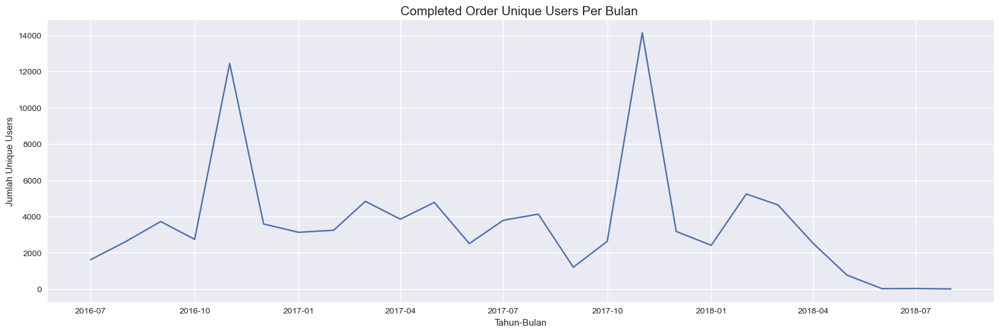

In [223]:
# Membuat tabel Unique users perbulan
uniqueUserCompleted = dfCompleted.groupby('M-Y')["Customer ID"].nunique().reset_index()

print('Total Unique Users =', df['Customer ID'].nunique())
print('Unique Users dari Completed Order=',dfCompleted['Customer ID'].nunique())
display(uniqueUserCompleted)

# Membuat visualisasi unique users perbulan
plt.style.use('seaborn')
plt.figure(figsize = (20,6))
sns.lineplot(   data=uniqueUserCompleted, 
                x=uniqueUserCompleted['M-Y'], 
                y=uniqueUserCompleted['Customer ID'])
plt.title('Completed Order Unique Users Per Bulan ', size = 15)
plt.xlabel('Tahun-Bulan')
plt.ylabel('Jumlah Unique Users')
plt.show()

Dari 584.314 order yang ada, jumlah Order yang selesai (*Completed*) dari Juli 2016 sampai dengan Agustus 2018 adalah sebanyak **233,684 Order** dengan **67,093 Unique User**.

Berdasarkan grafik di bawah dapat kita lihat bahwa setiap bulan mengalami fluktuasi, namun jumlah order naik secara signifikan pada bulan November: 
* 2016-11 : 37,492 order, 12,442 unique users
* 2017-11 : 38,817 order, 14,136 unique users

Hal tersebut diperkirakan karena meningkatnya keinginan untuk berbelanja saat mendekati tahun baru.


<h4>2. Lalu Berapa Total Gross Penjualan dari Completed Order Tersebut?</h4>
(Data Analisis - Sales Overview)


Total Gross Penjualan = 1077368682.5700002 Rupees


,M-Y,sum,cumulative_sum
0,2016-07-01,8.455900e+06,8.455900e+06
1,2016-08-01,1.519008e+07,2.364598e+07
2,2016-09-01,2.430523e+07,4.795121e+07
3,2016-10-01,1.739613e+07,6.534734e+07
4,2016-11-01,8.130949e+07,1.466568e+08
5,2016-12-01,1.963707e+07,1.662939e+08
6,2017-01-01,2.399517e+07,1.902891e+08
7,2017-02-01,1.909073e+07,2.093798e+08
8,2017-03-01,2.916175e+07,2.385415e+08
9,2017-04-01,2.329316e+07,2.618347e+08


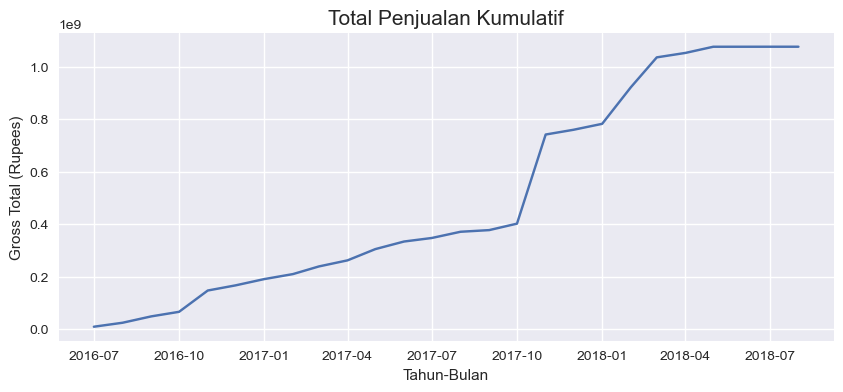

In [224]:
# Membuat tabel penjualan dan kumulatif penjualan perbulan
lineCompletedSum=dfCompleted.groupby('M-Y')['gross_total'].agg(['sum']).reset_index()
lineCompletedSum["cumulative_sum"] = lineCompletedSum['sum'].cumsum()

print('Total Gross Penjualan =', lineCompletedSum['sum'].sum(), 'Rupees')
display(lineCompletedSum)

# Membuat visualisasi kumulatif penjualan perbulan
plt.style.use('seaborn')
plt.figure(figsize = (10,4))
sns.lineplot(   data=lineCompletedSum, 
                x=lineCompletedSum['M-Y'], 
                y=lineCompletedSum['cumulative_sum'])
plt.title('Total Penjualan Kumulatif', size = 15)
plt.xlabel('Tahun-Bulan')
plt.ylabel('Gross Total (Rupees)')
plt.show()



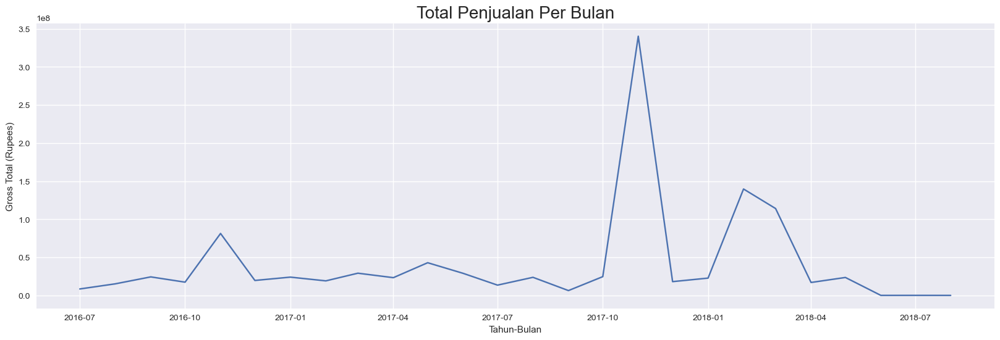

In [225]:
# Membuat visualisasi penjualan perbulan
plt.style.use('seaborn')
plt.figure(figsize = (20,6))
sns.lineplot(   data=lineCompletedSum, 
                x=lineCompletedSum['M-Y'], 
                y=lineCompletedSum['sum'])
plt.title('Total Penjualan Per Bulan', size = 20)
plt.xlabel('Tahun-Bulan')
plt.ylabel('Gross Total (Rupees)')
plt.show()

Penjualan dari order yang selesai (*Completed*) dari Juli 2016 sampai dengan Agustus 2018 mencapai  **1,077,368,682 Rupees**. 

Namun berdasarkan grafik dibawah, total penjualan pada saat jumlah order tertinggi yaitu pada 2017-11 berbeda cukup jauh dengan 2016-11, padahal memiliki jumlah order yang hampir sama.

* 2016-11 : 37,492 order,   **81,309,490 Rupees**
* 2017-11 : 38,817 order, **340,261,800 Rupees**

Mengapa bisa terjadi perbedaan yang cukup signifikan? mari kita periksa lebih lanjut.

<h4>3. Category Apa Yang Paling Banyak Diminati Dari Seluruh Transaksi?</h4>
(Data Analisis - Sales Overview)


,category_name_1,count
2,Books,1870
11,School & Education,3478
15,\N,7833
3,Computing,15933
7,Kids & Baby,16489
5,Health & Sports,17502
4,Entertainment,26322
6,Home & Living,26504
10,Others,29208
12,Soghaat,34011


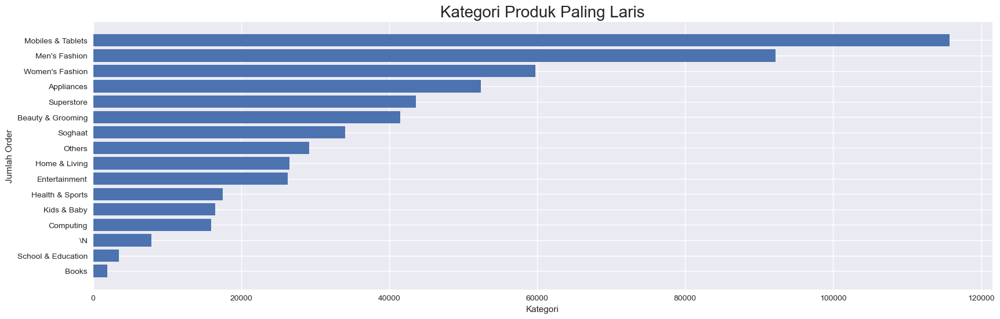

In [226]:
# Membuat tabel jumlah kategori produk dari semua transaski
categoryAll=df.groupby('category_name_1')['gross_total'].agg(['count']).reset_index().sort_values(by='count')
display(categoryAll)

# Membuat visualisasi jumlah kategori produk dari semua transaski
plt.style.use('seaborn')
plt.figure(figsize=(20,6))
plt.barh(categoryAll['category_name_1'],categoryAll['count'])
plt.title('Kategori Produk Paling Laris', size = 20)
plt.xlabel('Kategori')
plt.ylabel('Jumlah Order')
plt.show()

Kategori yang paling diminati dari seluruh transaksi adalah **Mobiles & Tablets sebanyak 115,709 order** diikuti kategori **Men's Fashion 92,218 order**.\
<br>
Lalu bagaimana dengan kategori paling diminati dari completed order?

<h4>4. Category Apa Yang Paling Banyak Diminati Dari Completed Order?</h4>
(Data Analisis - Sales Overview)


,category_name_1,count
2,Books,910
11,School & Education,1584
10,Others,3113
15,\N,3227
3,Computing,5735
7,Kids & Baby,7025
5,Health & Sports,8049
4,Entertainment,9327
6,Home & Living,11153
13,Superstore,16693


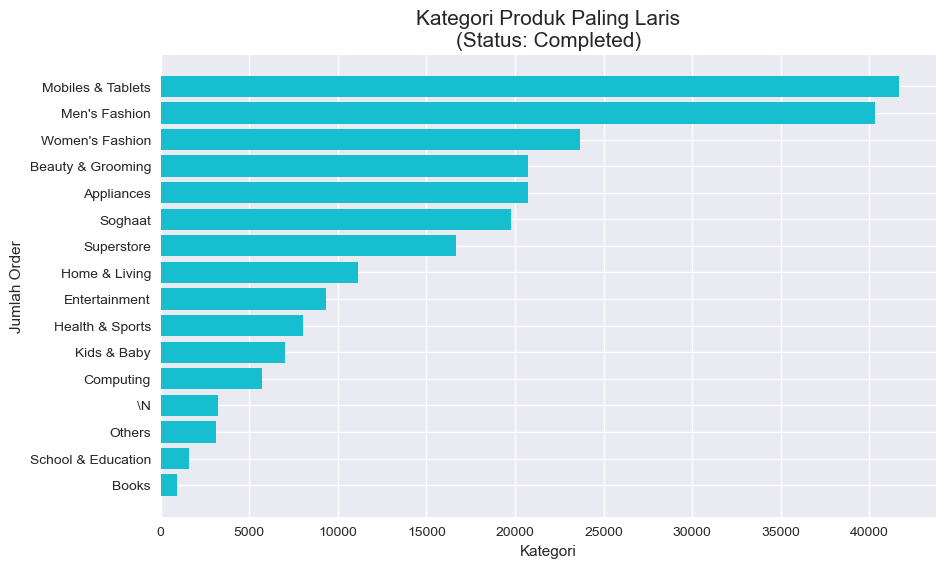

In [227]:
# Membuat tabel jumlah kategori produk dari completed order
categoryCompleted=dfCompleted.groupby('category_name_1')['gross_total'].agg(['count']).reset_index().sort_values(by='count')
display(categoryCompleted)

# Membuat visualisasi jumlah kategori produk dari completed order
plt.style.use('seaborn')
plt.figure(figsize=(10,6))
bars = plt.barh(categoryCompleted['category_name_1'],categoryCompleted['count'],color='tab:cyan')
plt.title('Kategori Produk Paling Laris\n(Status: Completed)', size = 15)
plt.xlabel('Kategori')
plt.ylabel('Jumlah Order')
plt.show()

Kategori yang paling diminati dari Completed Order adalah **Mobiles & Tablets sebanyak 41,658 order**.<br>

Hal tersebut selaras dengan data yang dihimpun oleh [Statista](https://www.statista.com/statistics/203734/global-smartphone-penetration-per-capita-since-2005/) dimana penetrasi smartphone secara global setiap tahunnya meningkat, termasuk juga Pakistan.

> *Lalu kenapa total penjualan pada 2017-11 berbeda jauh dengan total penjualan pada 2016-11? Padahal jumlah ordernya hampir sama.*<br>


In [228]:
print('Rata-Rata Harga Mobiles & Tablets: ', dfCompleted['price'][dfCompleted['category_name_1']=='Mobiles & Tablets'].mean())
print('Rata-Rata Harga Appliances: ',dfCompleted['price'][dfCompleted['category_name_1']=="Appliances"].mean())
print("Rata-Rata Harga Men's Fashion: ",dfCompleted['price'][dfCompleted['category_name_1']=="Men's Fashion"].mean())

# Membuat tabel jumlah kategori produk pada bulan 2016-11 dan 2017-11.
display(dfCompleted[['M-Y','category_name_1']][dfCompleted['M-Y']=='2016-11'].value_counts().reset_index())
display(dfCompleted[['M-Y','category_name_1']][dfCompleted['M-Y']=='2017-11'].value_counts().reset_index())


Rata-Rata Harga Mobiles & Tablets:  11217.765303423117
Rata-Rata Harga Appliances:  8656.273817180936
Rata-Rata Harga Men's Fashion:  758.4789233327527


,M-Y,category_name_1,0
0,2016-11-01,Men's Fashion,9283
1,2016-11-01,Mobiles & Tablets,5359
2,2016-11-01,Soghaat,4084
3,2016-11-01,Beauty & Grooming,3311
4,2016-11-01,Appliances,3055
5,2016-11-01,Women's Fashion,2800
6,2016-11-01,Superstore,2707
7,2016-11-01,Home & Living,1411
8,2016-11-01,Computing,1143
9,2016-11-01,Health & Sports,1096


,M-Y,category_name_1,0
0,2017-11-01,Mobiles & Tablets,10041
1,2017-11-01,Appliances,7333
2,2017-11-01,Men's Fashion,7069
3,2017-11-01,Entertainment,3062
4,2017-11-01,Women's Fashion,3059
5,2017-11-01,Home & Living,2290
6,2017-11-01,Beauty & Grooming,2140
7,2017-11-01,Computing,1173
8,2017-11-01,Superstore,1025
9,2017-11-01,Kids & Baby,703


Pada 2016-11, Category yang paling banyak dibeli adalah Men's Fashion dengan 9283 order dan rata-rata harga per barangnya 758 rupees.<br>
Sedangkan pada 2017-11, Category yang paling banyak dibeli adalah Mobiles & Tablets dengan 10,041 order dan rata-rata harga per barangnya 11,217 rupees<br>

Category Mobiles & Tablets memiliki rata-rata harga per barang yang jauh lebih tinggi sehingga mempengaruhi total gross penjualannya.

Berikut adalah Produk yang paling banyak dibeli pada saat 2017-11

In [229]:
display(dfCompleted[['M-Y','sku','category_name_1']][dfCompleted['M-Y']=='2017-11'].value_counts().reset_index())

,M-Y,sku,category_name_1,0
0,2017-11-01,MATSAM59DB75ADB2F80,Mobiles & Tablets,2665
1,2017-11-01,MATSAM5A0BFFEF4DA20,Mobiles & Tablets,500
2,2017-11-01,MATSAM5A0BFFEEED718,Mobiles & Tablets,441
3,2017-11-01,ENTECO5A0C1CCF5C177,Entertainment,399
4,2017-11-01,APPDAW59FF034935DBA,Appliances,360
...,...,...,...,...
6648,2017-11-01,KABEDE5A0C171095DC0-5 Years,Kids & Baby,1
6649,2017-11-01,KABEDE5A0C171095DC0-4 Years,Kids & Baby,1
6650,2017-11-01,KABEDE5A0C171095DC0-2-3 Years,Kids & Baby,1
6651,2017-11-01,KABEDE5A0C171095DC0-11-12 Years,Kids & Baby,1


<h4>5. Metode pembayaran apa yang paling banyak digunakan dari seluruh transaksi?</h4>
(Data Analisis - Sales Overview)


,payment_method,count
6,cod,271770
2,Payaxis,97640
0,Easypay,82893
12,jazzwallet,35145
8,easypay_voucher,31175
4,bankalfalah,23057
11,jazzvoucher,15633
1,Easypay_MA,14026
7,customercredit,7554
3,apg,1758


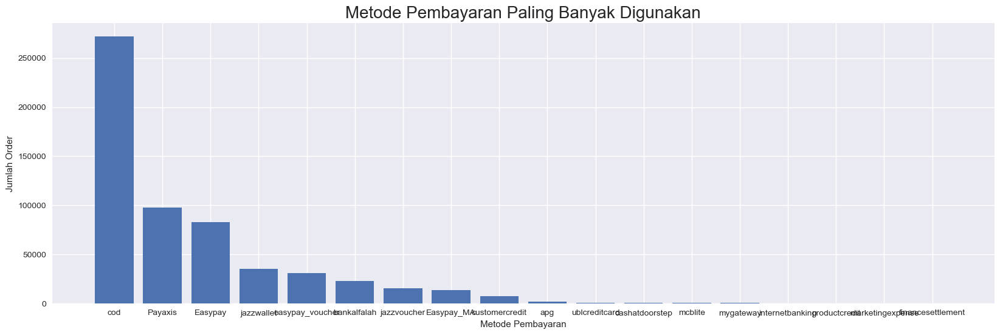

In [230]:
# Membuat tabel jumlah metode pembayaran dari seluruh transaksi
methodAll=df.groupby('payment_method')['gross_total'].agg(['count']).reset_index().sort_values(by='count',ascending=False)
display(methodAll)

# Membuat visualisasi jumlah metode pembayaran dari seluruh transaksi
plt.style.use('seaborn')
plt.figure(figsize=(20,6))
plt.bar(methodAll['payment_method'], methodAll['count'])
plt.title('Metode Pembayaran Paling Banyak Digunakan', size = 20)
plt.xlabel('Metode Pembayaran')
plt.ylabel('Jumlah Order')
plt.show()

Metode pembayaran yang paling banyak digunakan dari seluruh transaksi adalah **COD** dengan total **271.770 transaksi**.

<h4>6. Metode pembayaran apa yang paling banyak digunakan dari Completed Order?</h4>
(Data Analisis - Sales Overview)


,payment_method,count
6,cod,148038
2,Payaxis,22809
0,Easypay,19214
8,easypay_voucher,16066
12,jazzwallet,13505
11,jazzvoucher,4619
7,customercredit,4151
1,Easypay_MA,3116
5,cashatdoorstep,674
4,bankalfalah,586


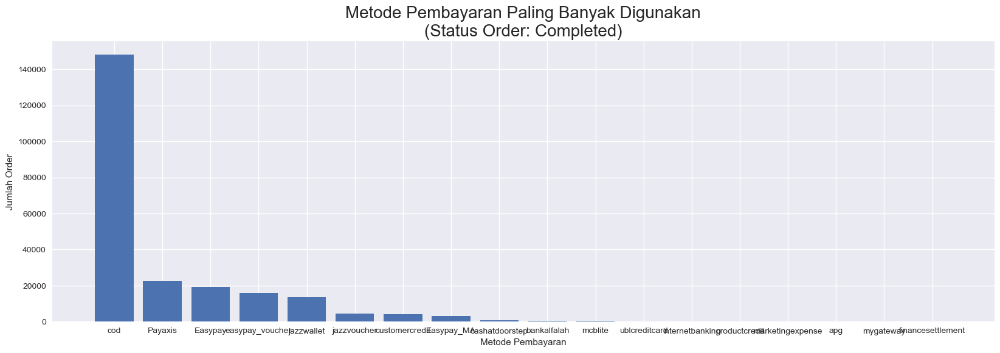

In [231]:
# Membuat tabel jumlah metode pembayaran dari completed order
methodCompleted=dfCompleted.groupby('payment_method')['gross_total'].agg(['count']).reset_index().sort_values(by='count',ascending=False)
display(methodCompleted)

# Membuat visualisasi jumlah metode pembayaran dari completed order
plt.style.use('seaborn')
plt.figure(figsize=(20,6))
plt.bar(methodCompleted['payment_method'], methodCompleted['count'])
plt.title('Metode Pembayaran Paling Banyak Digunakan\n(Status Order: Completed)', size = 20)
plt.xlabel('Metode Pembayaran')
plt.ylabel('Jumlah Order')
plt.show()

,payment,count
0,C O D,148038
1,Others,85646


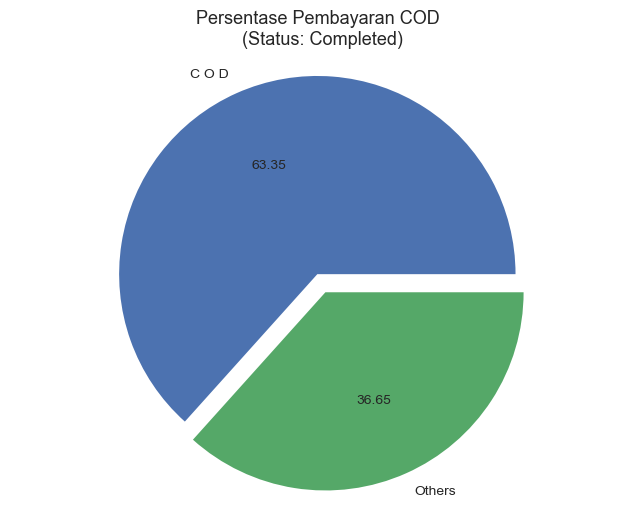

In [232]:
# Membuat tabel bantuan untuk membuat pie chart
pieMethodCompleted = pd.DataFrame({'payment': ['C O D' , 'Others'],
                                   'count':     [methodCompleted['count'].max(), 
                                                methodCompleted['count'].sum()-methodCompleted['count'].max()    ]})

display(pieMethodCompleted)

# Membuat pie chart COD vs Others
plt.style.use('seaborn')
plt.figure(figsize=(8,6))
plt.pie(pieMethodCompleted['count'], 
        labels = pieMethodCompleted['payment'],
        autopct = '%.2f',
        explode = (0.1,0)
        )
plt.title('Persentase Pembayaran COD \n (Status: Completed)', size = 13)
plt.axis('equal')
plt.show()

Metode pembayaran yang paling banyak digunakan dari completed order adalah **COD** dengan total **148,038 completed order**. Angka tersebut mencapai **63.35%** dari total transaksi yang completed. <br>

Ditulis dalam open jurnal yang diterbitkan oleh Safia Anjum and Junwu Chai dengan judul "**Drivers of Cash-on-Delivery Method of Payment in E-Commerce Shopping: Evidence From Pakistan**" bahwa customers di Pakistan lebih menyukai metode pembayaran secara COD karena memberikan rasa aman dan kemudahan.

> *"It was observed that COD is a desired payment option of Pakistani customers as it provides them a sense of security and ease."*

[Baca Jurnal](https://journals.sagepub.com/doi/full/10.1177/2158244020917392)

<h4>7. Berapa jumlah order berdasarkan pengelompokan Status?</h4>
(Data Analisis - Sales Overview)


,status_distinct,count
1,Completed,233684
0,Cancelled,201127
2,Processing,90005
3,Refunded,59498


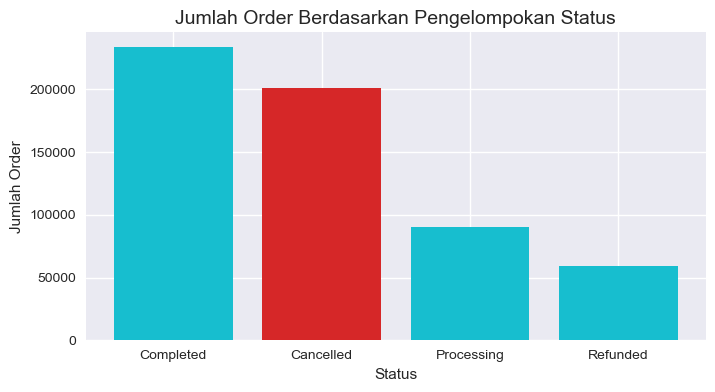

In [233]:
# Membuat tabel jumlah status distinct
statusAll=df.groupby('status_distinct')['gross_total'].agg(['count']).reset_index().sort_values(by='count',ascending=False).head(10)
display(statusAll)

# Membuat visualisasi jumlah status distinct
plt.style.use('seaborn')
plt.figure(figsize=(8,4))
plt.bar(statusAll['status_distinct'], statusAll['count'],color = [ 'tab:cyan','tab:red', 'tab:cyan', 'tab:cyan'])
plt.title('Jumlah Order Berdasarkan Pengelompokan Status', size = 14)
plt.xlabel('Status')
plt.ylabel('Jumlah Order')
plt.show()

Jumlah completed order adalah 233,684 order, **jumlah cancelled order adalah 201,127 order**. Jumlah cancelled order hampir menyamai jumlah completed order dan ini harus menjadi perhatian kita.

<h4>8. Berapa potensi yang hilang dari cancelled order?</h4>
(Data Analisis - Sales Overview)


Jika dihitung dengan gross total, total gross penjualan dari cancelled order berpotensi mencapai **2,435,877,000 Rupees**. Ini adalah potensi yang bernilai cukup besar jika jika kita dapat mengkonversinya menjadi completed order. Potensi tersebut mencapai 58.07% dari seluruh transaksi yang ada, sedangkan order completed yang telah terrealisasi adalah 25,68 %nya. <br>

Maka dari itu kita perlu menggali lebih dalam mengenai cancelled order ini.

,status_distinct,sum
0,Cancelled,2.435877e+09
1,Completed,1.077369e+09
3,Refunded,3.637712e+08
2,Processing,3.179786e+08


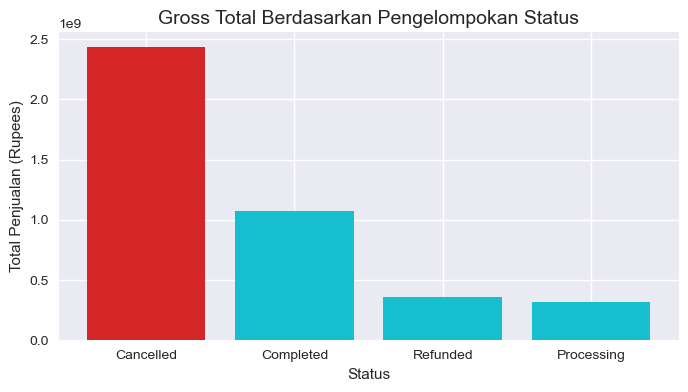

In [234]:
# Membuat tabel gross penjualan berdasarkan status distinct
statusAll=df.groupby('status_distinct')['gross_total'].agg(['sum']).reset_index().sort_values(by='sum',ascending=False).head(10)
display(statusAll)

# Membuat visualisai gross penjualan berdasarkan status distinct
plt.style.use('seaborn')
plt.figure(figsize=(8,4))
plt.bar(statusAll['status_distinct'], statusAll['sum'],color = ['tab:red', 'tab:cyan', 'tab:cyan', 'tab:cyan'])
plt.title('Gross Total Berdasarkan Pengelompokan Status', size = 14)
plt.xlabel('Status')
plt.ylabel('Total Penjualan (Rupees)')
plt.show()

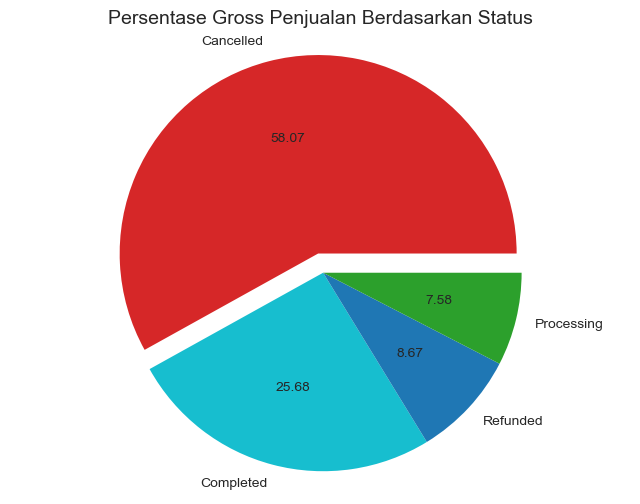

In [235]:
# Membuat piechart gross penjualan berdasarkan status
plt.style.use('seaborn')
plt.figure(figsize=(8,6))
plt.pie(statusAll['sum'], 
        labels = statusAll['status_distinct'],
        autopct = '%.2f',
        explode = (0.1,0,0,0),
        colors = ['tab:red', 'tab:cyan', 'tab:blue', 'tab:green']
        )
plt.axis('equal')
plt.title('Persentase Gross Penjualan Berdasarkan Status', size = 14)
plt.show()

<h2>Data Analisis</h2>
4. CANCELLED ORDER ANALYSIS

Pertama, mari kita membuat tabel yang dikelompokkan dengan status *Cancelled*.\
Kemudian kita akan melakukan analisis untuk menjawab pertanyan berikut:
1. **Category** apa yang paling banyak mengalami Cancelled orders?
1. **Metode pembayaran** apa yang paling banyak mengalami Cancelled orders?
1. Bagaimana pengaruh harga produk terhadap status order?



In [236]:
#Membuat tabel dengan pengelompokan status Cancelled
dfCancelled = df[df['status_distinct']=='Cancelled']
dfCancelled.head()

,item_id,status,created_at,sku,price,qty_ordered,grand_total,increment_id,category_name_1,discount_amount,payment_method,Year,Month,Customer Since,M-Y,FY,Customer ID,gross_total,status_distinct
1,211133.0,canceled,2016-07-01,kcc_Buy 2 Frey Air Freshener & Get 1 Kasual Bo...,240.0,1.0,240.0,100147444,Beauty & Grooming,0.0,cod,2016.0,7.0,2016-7,2016-07-01,FY17,2.0,240.0,Cancelled
2,211134.0,canceled,2016-07-01,Ego_UP0017-999-MR0,2450.0,1.0,2450.0,100147445,Women's Fashion,0.0,cod,2016.0,7.0,2016-7,2016-07-01,FY17,3.0,2450.0,Cancelled
5,211137.0,canceled,2016-07-01,UK_Namkino All In One 200 Gms,80.0,1.0,80.0,100147448,Soghaat,0.0,cod,2016.0,7.0,2016-7,2016-07-01,FY17,6.0,80.0,Cancelled
8,211140.0,canceled,2016-07-01,Apple iPhone 6S 64GB,96499.0,1.0,96499.0,100147451,Mobiles & Tablets,0.0,ublcreditcard,2016.0,7.0,2016-7,2016-07-01,FY17,8.0,96499.0,Cancelled
9,211141.0,canceled,2016-07-01,Apple iPhone 6S 64GB,96499.0,1.0,96499.0,100147452,Mobiles & Tablets,0.0,mygateway,2016.0,7.0,2016-7,2016-07-01,FY17,8.0,96499.0,Cancelled


<h4>1. Category apa yang paling banyak mengalami Cancelled orders?</h4>
(Data Analisis - Cancelled Orders Analysis)

,category_name_1,count
9,Mobiles & Tablets,53715
8,Men's Fashion,22024
0,Appliances,21628
10,Others,18364
14,Women's Fashion,15961
13,Superstore,13926
4,Entertainment,12578
1,Beauty & Grooming,9686
12,Soghaat,7593
6,Home & Living,7199


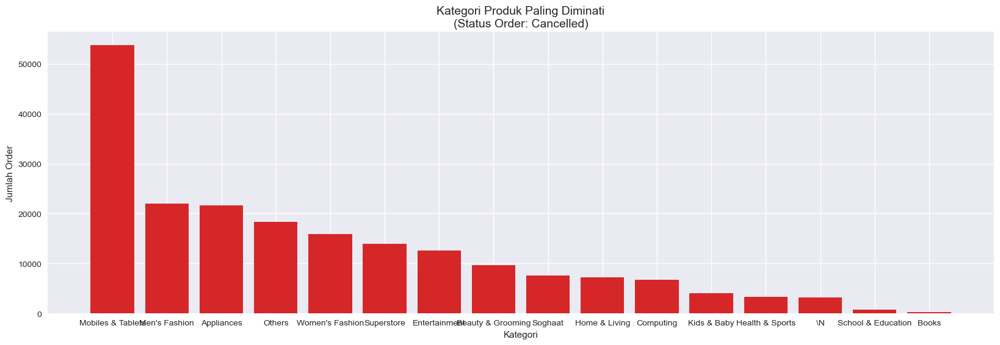

In [237]:
# Membuat tabel jumlah kategori produk berdasarkan cancelled order
categoryCancelled=dfCancelled.groupby('category_name_1')['gross_total'].agg(['count']).reset_index().sort_values(by='count',ascending=False)
display(categoryCancelled)

# Membuat visualisasi jumlah kategori produk berdasarkan cancelled order
plt.style.use('seaborn')
plt.figure(figsize=(20,6))
plt.bar(categoryCancelled['category_name_1'], categoryCancelled['count'], color='tab:red')
plt.title('Kategori Produk Paling Diminati\n(Status Order: Cancelled)', size = 14)
plt.xlabel('Kategori')
plt.ylabel('Jumlah Order')
plt.show()

Sama seperti Completed Order, Category yang paling banyak mengalami cancelled adalah Mobiles & Tablets. <br>

Permintaan akan Mobiles & Tablets ini memang sedang tinggi. Namun mengapa transaksi bisa cancelled? Apakah karena metode pembayarannya? atau apakah harga yang tinggi mempengaruhi keputusan pembeli untuk menyelesaikan pembelian? <br>

Mari kita lihat metode pembayaran dan harga produknya.

<h4>2. Metode pembayaran apa yang paling banyak mengalami Cancelled orders?</h4>
(Data Analisis - Cancelled Orders Analysis)


,payment_method,count
2,Payaxis,61267
0,Easypay,52034
6,cod,21644
12,jazzwallet,16933
4,bankalfalah,16179
8,easypay_voucher,12188
1,Easypay_MA,9209
11,jazzvoucher,8472
3,apg,1361
16,ublcreditcard,660


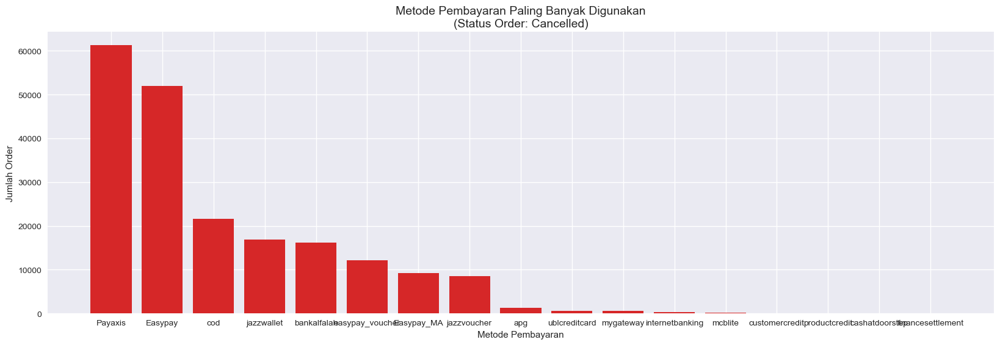

In [238]:
# Membuat tabel jumlah metode pembayaran berdasarkan cancelled order
categoryCancelled=dfCancelled.groupby('payment_method')['gross_total'].agg(['count']).reset_index().sort_values(by='count',ascending=False)
display(categoryCancelled)

# Membuat visualisasi jumlah metode pembayaran berdasarkan cancelled order
plt.style.use('seaborn')
plt.figure(figsize=(20,6))
plt.bar(categoryCancelled['payment_method'], categoryCancelled['count'], color='tab:red')
plt.title('Metode Pembayaran Paling Banyak Digunakan\n(Status Order: Cancelled)', size = 14)
plt.xlabel('Metode Pembayaran')
plt.ylabel('Jumlah Order')
plt.show()

Metode pembayaran yang paling banyak mengalami cancelled order adalah pembayaran elektronik *Payaxis* dan *Easypay*.<br>

Seperti dituliskan dalam jurnal yang telah disebutkan sebelumnya, bahwa keamanan yang dirasakan dan kontrol atas proses pembelian adalah faktor terpenting yang mendorong pelanggan Pakistan untuk memilih COD. Maka atas dasar itulah, kemungkinan customer di Pakistan memilih untuk membatalkan atau memilih untuk tidak melanjutkan pesanan yang telah dibuat.

> *"E-payment for online shopping is not a popular approach among Pakistani customers."*<br>
> *" This study determined that perceived security, control over the buying process, and EU were the most important factors prompting Pakistani customers to choose COD."*

Selain itu, perlu juga untuk ditinjau lebih lanjut apakah ada permasalahan dari Pembayaran Elektronik tersebut. Apakah UI sulit untuk dimengerti atau masalah integrasi antara ecommerce dengan e-payment yang mengakibatkan pembayaran menjadi gagal.

<h4>3. Bagaimana pengaruh harga produk terhadap status order??</h4>
(Data Analisis - Cancelled Orders Analysis)

Berikut adalah sebaran harga produk berdasarkan pengelompokan status ordernya.

Dari grafik dapat kita lihat, seperti status order lainnya, harga produk tersebar dari yang rendah hingga tertinggi ada pada setiap status order.<br>
Namun dapat kita lihat untuk produk dengan harga diatas 200,000 Rupees dipastikan mengalami cancelled order dan ada beberapa yang di refunded. 

Pertama mari kita lihat produk apa saja yang mempunyai harga diatas 200,000 rupees?<br>

In [239]:
fig = px.scatter(df, y='status_distinct', x='price')
fig.show()

Berikut adalah produk dengan harga lebih dari 200.000 Rupees. Produk didominasi oleh category computing dan entertainment. Uniknya adalah seluruh order tersebut menggunakan e-payment. Tidak ada yang menggunakan COD, atau mungkin memang untuk produk dengan harga demikian tidak menyediakan metode COD.

In [240]:
dfCancelled[['item_id','sku','category_name_1','price','payment_method']].sort_values(by='price',ascending=False)[dfCancelled['price']>195000]

/var/folders/2x/skq8kcjs21j13cfhv6mbf_600000gn/T/ipykernel_98632/1489294213.py:1: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



,item_id,sku,category_name_1,price,payment_method
509081,821284.0,BAGGEM5A7038AC06C9A,Beauty & Grooming,1012625.9,jazzvoucher
309775,588634.0,ENTSAM59B7C1FA12478,Entertainment,515975.0,Payaxis
207347,470297.0,yamaha_EF12000E,Appliances,479000.0,Easypay
207276,470222.0,yamaha_EF12000E,Appliances,479000.0,Easypay
251158,521539.0,yamaha_EF12000E,Appliances,479000.0,Easypay
124009,366057.0,"samsung_SUHD TV KS 8000 60""",Entertainment,330499.0,Payaxis
182896,442111.0,Samsung_60KS8000,Entertainment,330499.0,Easypay
423756,722836.0,ENTSAM5A0D70359FBCA,Entertainment,320000.0,Easypay
341453,625443.0,COMAPP5A0C479C9FD5C,Computing,307970.0,Easypay_MA
341534,625537.0,COMAPP5A0C479C9FD5C,Computing,307970.0,easypay_voucher


Kemudian apakah ada perbedaan mean/median harga produk dari cancelled order dengan completed order? Mari kita lakukan uji secara statistik.

In [241]:
# cek distribusi kolom price
from scipy.stats import normaltest
stats, pval=normaltest(df['price'])
if pval<=0.05:
    print('Distribusi kolom Price: Tidak Normal')
else: 
    print('Distribusi kolom Price: Normal') 

Distribusi kolom Price: Tidak Normal


<b>Hipotesis: </b> <br>
<b>H0 </b>: Median harga produk Cancelled Order = Median harga produk Completed Order <br>
<b>H1 </b>: Median harga produk Cancelled Order > Median harga produk Completed Order

Uji statistik, apakah ada perbedaan harga antara produk yang mengalami cancelled order dengan produk yang completed order.<br>
Karena distribusi data tidak normal, gunakan Mann Whitney

In [242]:
from scipy.stats import mannwhitneyu

resultmann = list(mannwhitneyu(
    df[df['status_distinct']=='Cancelled']['price'],
    df[df['status_distinct']=='Completed']['price'],
    alternative = 'greater'))

print('P-Value:',resultmann[1])

if resultmann[1] <= 0.05 :

    print('Tolak Ho')
else:
    print('Gagal menolak Ho')

P-Value: 0.0
Tolak Ho


P-Value lebih rendah dari tingkat signifikansi kita 0.05, artinya kita memiliki cukup bukti untuk menolak Hipotesis Nol. Jadi, Median harga produk yang mengalami cancelled order lebih tinggi dari median harga produk completed order. Harga produk yang mengalami cancelled order cenderung lebih tinggi dari yang completed.

Mari kita lihat median harga statusnya.

In [243]:
df.groupby('status_distinct')['price'].median()

status_distinct
Cancelled     1599.0
Completed      749.0
Processing     599.0
Refunded       999.0
Name: price, dtype: float64

***
<h2>Kesimpulan dan Rekomendasi</h2>


**Kesimpulan**

Dari analisis yang telah dilakukan, kita dapat membuat kesimpulan tentang penjualan dari Juli 2016 sampai dengan Agustus 2018 sebagai berikut:<br>

1. **Garis Besar Penjualan**
* Dari 584.314 order yang ada, jumlah order yang selesai (*Completed*) ada sebanyak **233,684 Order** atau senilai **1,077,368,682 Rupees**. 
* Bulan dengan penjualan tertinggi ada pada bulan November.
* Kategori yang paling laris adalah Mobiles & Tablets diikuti dengan Men's Fashion.
* Metode pembayaran yang paling banyak digunakan pada order yang *completed* adalah Cash On Delivery (COD).


2. **Cancelled Order**<br>
* Total order yang batal atau tidak dilanjutkan ada sebanyak **201,127 Order** dengan potensi penjualan mencapai **2,435,877,000 Rupees**.
* Kategori yang paling diminati adalah Mobiles & Tablets diikuti dengan Men's Fashion.
* Metode pembayaran yang paling banyak digunakan pada order yang *cancelled* adalah *e-payment* Payaxis dan Easypay.
* Harga produk yang tinggi lebih berpotensi menjadi cancelled order.

3. Keamanan dan Kemudahan menjadi poin penting bagi pelanggan di Pakistan.

**Rekomendasi**
1. Membuat campaign edukasi bahwa platform e-commerce ini aman untuk transaksi
1. Meng-improve UI / UX untuk kemudahan pengguna.
1. Lakukan banyak promosi pada bulan dengan penjualan tertinggi yaitu November.
1. Lakukan program upselling dan cross-selling untuk kategori Mobile & Tablets.
1. Membuat awareness campaign bahwa platform e-commerce ini mendukung COD.
1. Melakukan edukasi pelanggan tentang kemudahan pembayaran menggunakan e-payment.
1. Membuat skema cicilan untuk produk berharga tinggi.

Dengan melakukan hal tersebut diharapkan dapat meningkatkan penjualan dari platform e-commerce dan juga mengurangi jumlah *cancell order*.

##### Terima kasih.
***